# Patent Citation Network

U.S. patent dataset is maintained by the [National Bureau of Economic Research](http://www.nber.org/). The data set spans 37 years (January 1, 1963 to December 30, 1999), and includes all the utility patents granted during that period, totaling 3,923,922 patents. The citation graph includes all citations made by patents granted between 1975 and 1999, totaling 16,522,438 citations. For the patents dataset there are 1,803,511 nodes for which we have no information about their citations (we only have the in-links).

The data was originally released by [NBER](http://www.nber.org/patents/). The dataset can be found at this link: [Stanford Patent Citation Network](https://snap.stanford.edu/data/cit-Patents.html)

## Import Packages

In [1]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
from random import randint
import random

%matplotlib inline

## Import data

In [2]:
patent = pd.read_csv(
    "http://snap.stanford.edu/data/cit-Patents.txt.gz",
    compression="gzip",
    sep="\t",
    names=["start_node", "end_node"],
    skiprows=5
)

In [3]:
patent.head()

,start_node,end_node
0,3858241,1324234
1,3858241,3398406
2,3858241,3557384
3,3858241,3634889
4,3858242,1515701


In [25]:
patent.shape

(16518947, 2)

## Build Recommendation System

build a recommendation system based on Node2Vec with the patent information, remember to do a descriptive analysis and apply visualizations.

Also, remember that when making a recommendation about which patent should be associated with another, make a visualization of the recommendation.

Descriptive Analysis

In [4]:
pip install python-louvain

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 204.6/204.6 kB 4.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for python-louvain: filename=python_louvain-0.16-py3-none-any.whl size=9388 sha256=f56f3f0abfd3adfb927df87885ce60dd84d858ac0b4bb5c49f00cf98fc320b03
  Stored in directory: /root/.cache/pip/wheels/d0/b0/d7/6dd26c3817810fa379088eaeb755a01d9a2a411c37632079d1
Successfully built python-louvain


In [6]:
print(patent.describe())

         start_node      end_node
count  1.651895e+07  1.651895e+07
mean   5.084096e+06  4.034245e+06
std    6.052737e+05  1.033726e+06
min    3.858241e+06  1.000000e+00
25%    4.593744e+06  3.520457e+06
50%    5.154215e+06  4.198037e+06
75%    5.611701e+06  4.780852e+06
max    6.009554e+06  5.991572e+06


In [7]:
G = nx.from_pandas_edgelist(patent, "start_node", "end_node", create_using=nx.DiGraph())

In [8]:
# Estadísticas descriptivas de la red
print(f"Número de nodos: {len(G.nodes)}")
print(f"Número de enlaces: {len(G.edges)}")
print(f"Grado promedio de los nodos: {sum(dict(G.degree()).values()) / len(G.nodes)}")

Número de nodos: 3774767
Número de enlaces: 16518947
Grado promedio de los nodos: 8.752300208198282


In [9]:
# Coeficiente de agrupamiento
clustering_coefficient = nx.average_clustering(G)
print(f"Coeficiente de agrupamiento promedio: {clustering_coefficient}")

Coeficiente de agrupamiento promedio: 0.03783080403879283


In [10]:
# cantidad de subgrafos
connected_components = list(nx.connected_components(G.to_undirected()))
num_subgraphs = len(connected_components)
print(f"La cantidad de subgrafos en el grafo es: {num_subgraphs}")

La cantidad de subgrafos en el grafo es: 3627


In [11]:
# Obtener la lista de componentes conectadas ordenadas de mayor a menor
connected_components_sorted = sorted(connected_components, key=len, reverse=True)

# Iterar a través de las componentes conectadas ordenadas
for i, componente in enumerate(connected_components_sorted):
    num_nodos = len(componente)
    print(f"Subgrafo {i + 1}: Número de Nodos = {num_nodos}, Nodos = {list(componente)}")

Subgrafo 1: Número de Nodos = 3764116, Nodos = [1, 13, 24, 29, 31, 42, 51, 52, 53, 84, 87, 92, 105, 107, 115, 168, 175, 178, 179, 186, 187, 189, 198, 202, 226, 227, 231, 244, 247, 252, 284, 311, 312, 315, 326, 339, 340, 342, 350, 364, 391, 401, 415, 417, 424, 427, 428, 432, 441, 449, 482, 489, 524, 535, 542, 564, 567, 583, 591, 595, 678, 689, 702, 721, 731, 738, 745, 772, 790, 796, 799, 834, 835, 836, 843, 844, 854, 874, 894, 905, 907, 919, 948, 957, 958, 960, 970, 985, 993, 996, 997, 1003, 1014, 1016, 1056, 1070, 1092, 1096, 1115, 1124, 1129, 1130, 1150, 1166, 1174, 1183, 1192, 1193, 1203, 1243, 1246, 1249, 1279, 1287, 1290, 1304, 1328, 1330, 1332, 1333, 1339, 1343, 1359, 1374, 1412, 1424, 1454, 1455, 1459, 1460, 1462, 1467, 1470, 1474, 1478, 1482, 1489, 1505, 1565, 1567, 1568, 1572, 1574, 1583, 1615, 1619, 1648, 1660, 1677, 1685, 1714, 1743, 1772, 1774, 1792, 1796, 1826, 1832, 1836, 1841, 1845, 1864, 1867, 1874, 1887, 1893, 1897, 1902, 1905, 1907, 1908, 1924, 1925, 1929, 1930, 1931, 

In [12]:
#Densidad
nx.density(G)

1.1593169229825479e-06

In [13]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import random
random_seed=40
random.seed(random_seed)
# Seleccionar un subconjunto aleatorio de nodos para visualizar - muestra
num_nodes_to_visualize = 21000
nodes_to_visualize = random.sample(list(G.nodes()), num_nodes_to_visualize)

# Crear un subgrafo con los nodos seleccionados
subgraph = G.subgraph(nodes_to_visualize)

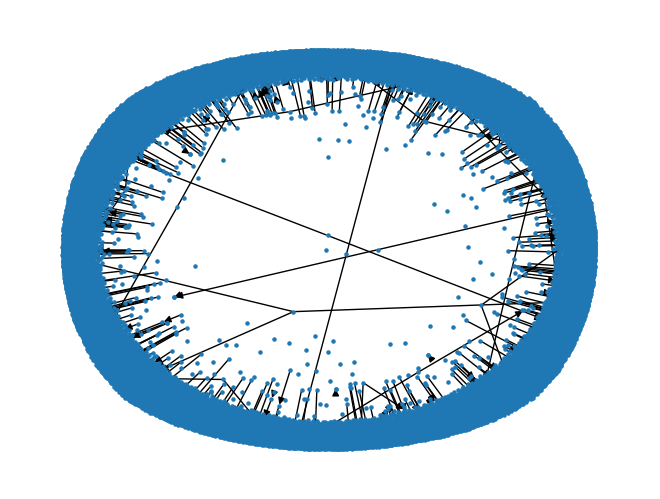

In [14]:
# Dibujar el subgrafo
pos = nx.spring_layout(subgraph)  # Distribución de los nodos en el subgrafo
nx.draw(subgraph, pos, with_labels=False, node_size=5)

# Mostrar el subgrafo
plt.show()

In [15]:
# Detectar comunidades en el subgrafo
communities = nx.algorithms.community.greedy_modularity_communities(subgraph)

print("Comunidades detectadas en el subgrafo:")
for i, community in enumerate(communities):
    print(f"Comunidad {i + 1}: {list(community)}")

Streaming output truncated to the last 5000 lines.
Comunidad 15500: [4817220]
Comunidad 15501: [885063]
Comunidad 15502: [5079387]
Comunidad 15503: [4555101]
Comunidad 15504: [5472620]
Comunidad 15505: [5865838]
Comunidad 15506: [4292982]
Comunidad 15507: [2326903]
Comunidad 15508: [3375491]
Comunidad 15509: [5210511]
Comunidad 15510: [2851236]
Comunidad 15511: [2589110]
Comunidad 15512: [4030905]
Comunidad 15513: [4817339]
Comunidad 15514: [3899836]
Comunidad 15515: [3899847]
Comunidad 15516: [2326987]
Comunidad 15517: [754123]
Comunidad 15518: [1802699]
Comunidad 15519: [3375576]
Comunidad 15520: [5734892]
Comunidad 15521: [4424188]
Comunidad 15522: [4555260]
Comunidad 15523: [2195967]
Comunidad 15524: [4555277]
Comunidad 15525: [5341715]
Comunidad 15526: [3113493]
Comunidad 15527: [3506714]
Comunidad 15528: [4948507]
Comunidad 15529: [3506735]
Comunidad 15530: [4162097]
Comunidad 15531: [5472828]
Comunidad 15532: [2064962]
Comunidad 15533: [2720325]
Comunidad 15534: [5472842]
Comuni

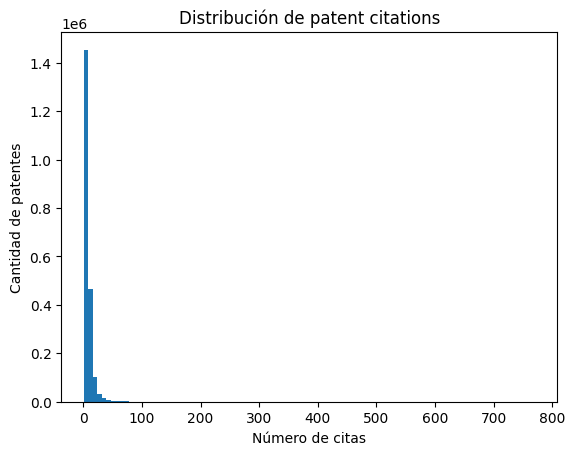

In [16]:
#PATENT CITATIONS DISTRIBUTION
import matplotlib.pyplot as plt

# Calculate the distribution of patent citations
citation_counts = patent["start_node"].value_counts()

plt.hist(citation_counts, bins=100)
plt.title("Distribución de patent citations")
plt.xlabel("Número de citas")
plt.ylabel("Cantidad de patentes")
plt.show()

Sistema de recomendación

In [17]:
!pip install node2vec
from node2vec import Node2Vec

In [18]:
todos_los_nodos = list(G.nodes())
nodos_seleccionados = todos_los_nodos[:100000]
subgrafo = G.subgraph(nodos_seleccionados)


node2vec = Node2Vec(subgrafo, dimensions=100, walk_length=10, num_walks=10, p=2, q=1, workers=2)
model = node2vec.fit(window=10, min_count=1, batch_words=4)

Computing transition probabilities:   0%|          | 0/100000 [00:00<?, ?it/s]

In [19]:
model.wv.index_to_key[120]

'3149104'

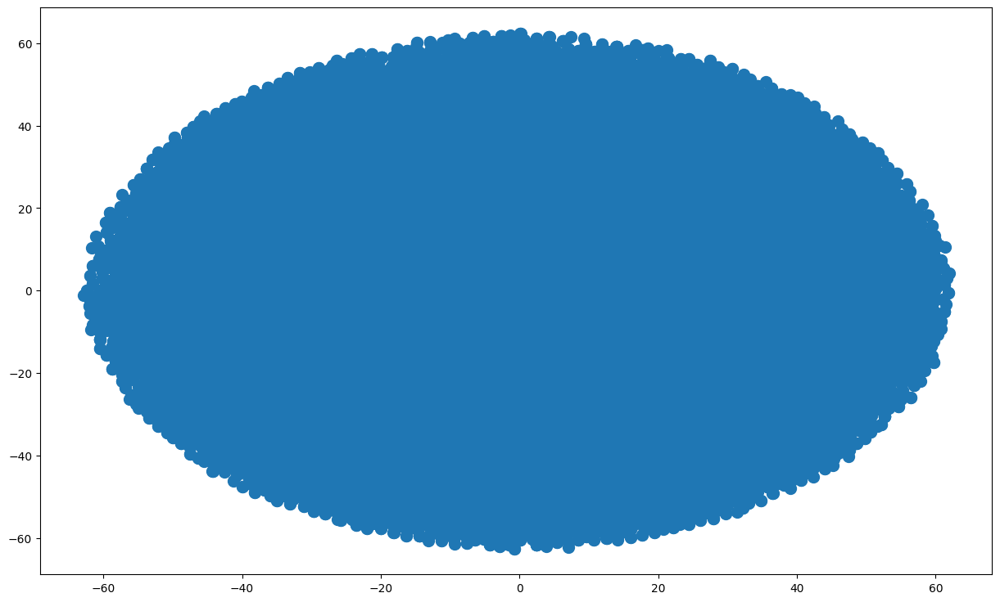

In [20]:
from sklearn.manifold import TSNE
import numpy as np

# Preprocess word vectors and label
nodes_wv = np.array([model.wv.get_vector(str(i)) for i in model.wv.index_to_key])

# Train TSNE
tsne = TSNE(n_components=2,
            learning_rate='auto',
            init='pca',
            random_state=0).fit_transform(nodes_wv)

# Plot TSNE
plt.figure(figsize=(15, 9))
plt.scatter(tsne[:, 0], tsne[:, 1], s=100)
plt.show()

In [28]:
def recommend(node_id):
    recommendations = model.wv.most_similar(str(node_id))
    return recommendations

In [29]:
# Suponiendo que ya tienes un modelo Node2Vec entrenado llamado 'model'
from gensim.models import KeyedVectors

# Acceder a los vectores de palabras del modelo
word_vectors = model.wv

# Obtener la lista de índices (nodos) presentes en el modelo
nodos_presentes = word_vectors.index_to_key

# Imprimir los nodos presentes
print(nodos_presentes)

['3538166', '3697507', '3783152', '3784390', '3597427', '3658634', '3731986', '3584362', '3031372', '3312730', '3255240', '3309371', '3564353', '3225055', '3371090', '2683709', '3534029', '2775599', '3681343', '3741980', '3816434', '3726895', '3165550', '3423487', '3725383', '3801654', '3700661', '3284344', '3736590', '3342810', '3579501', '3310865', '3475431', '3607352', '3793342', '3703524', '3666495', '3755300', '3555123', '3725295', '2635112', '3536721', '2817662', '3770695', '3228829', '3600427', '3767674', '3773795', '3706821', '3394218', '3585243', '3326663', '3705039', '3560441', '2999052', '3809699', '3758935', '3773971', '3712885', '3527677', '3521187', '3387044', '3820100', '3634227', '3765011', '3573064', '3477363', '3354129', '3717609', '3404975', '3022581', '3678333', '3153636', '3603833', '3651454', '2993799', '3757998', '3412149', '3594384', '3676115', '3774177', '3780178', '3372373', '3669980', '3740665', '3676401', '3385819', '3730532', '3746886', '3617753', '3706549'

In [47]:
recommendations = recommend(2864689)
print(recommendations)

[('3642572', 0.4430912435054779), ('3200255', 0.41367992758750916), ('3099875', 0.4117758274078369), ('3566866', 0.39871084690093994), ('3537416', 0.38364338874816895), ('3329741', 0.3751199543476105), ('2932124', 0.3750332295894623), ('3667057', 0.37101536989212036), ('3730851', 0.3692159354686737), ('1045307', 0.36762282252311707)]


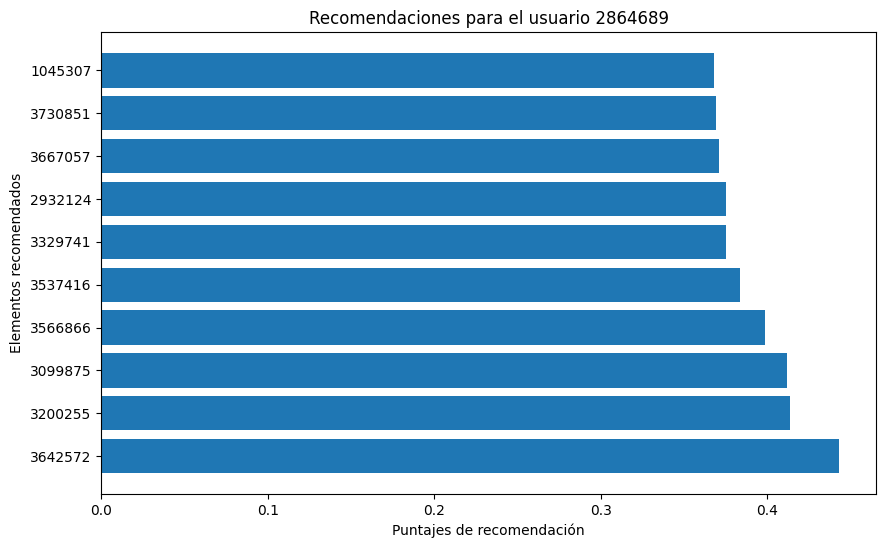

In [48]:
# Descomponer la lista de recomendaciones en elementos y puntajes
elementos = [item[0] for item in recommendations]
puntajes = [item[1] for item in recommendations]

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))  # Ajusta el tamaño del gráfico si es necesario
plt.barh(elementos, puntajes)  # Utiliza barh para barras horizontales
plt.xlabel('Puntajes de recomendación')
plt.ylabel('Elementos recomendados')
plt.title('Recomendaciones para el usuario 2864689')

plt.show()  # Muestra el gráfico

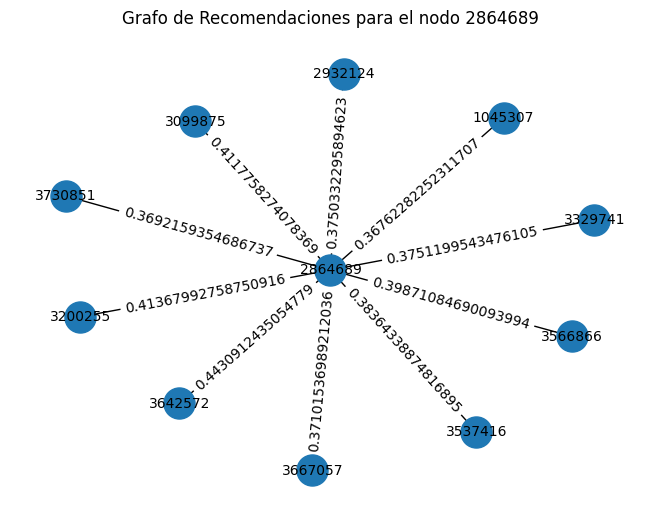

In [49]:
# Crear un grafo vacío
G = nx.Graph()

# Agregar el nodo original
node_id = 2864689
G.add_node(node_id)

recommendations = recommend(node_id)

for recommendation, similarity in recommendations:
    G.add_node(recommendation)
    G.add_edge(node_id, recommendation, weight=similarity)

# Dibujar el grafo
pos = nx.spring_layout(G)  # Asignar posiciones a los nodos
labels = {node: node for node in G.nodes()}
edge_labels = nx.get_edge_attributes(G, 'weight')

nx.draw(G, pos, with_labels=True, labels=labels, node_size=500, font_size=10)
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)

plt.title(f"Grafo de Recomendaciones para el nodo {node_id}")
plt.show()

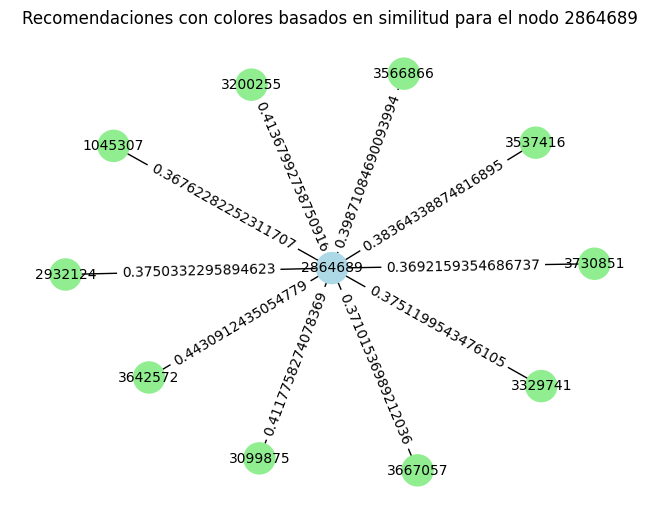

In [50]:
# Crear el grafo vacío
G = nx.Graph()

# Agregar el nodo original
node_id = 2864689
G.add_node(node_id)

recommendations = recommend(node_id)

# Agregar nodos recomendados y sus aristas
for recommendation, similarity in recommendations:
    G.add_node(recommendation)
    G.add_edge(node_id, recommendation, weight=similarity)

# Dibujar el grafo con colores para destacar la similitud
pos = nx.spring_layout(G)
labels = {node: node for node in G.nodes()}
edge_labels = nx.get_edge_attributes(G, 'weight')

# Colorear los nodos según la similitud (peso de la arista)
node_colors = ['lightblue' if node == node_id else 'lightgreen' for node in G.nodes()]

# Dibujar nodos y aristas
nx.draw(G, pos, with_labels=True, labels=labels, node_color=node_colors, node_size=500, font_size=10)
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)

plt.title(f"Recomendaciones con colores basados en similitud para el nodo {node_id}")
plt.show()

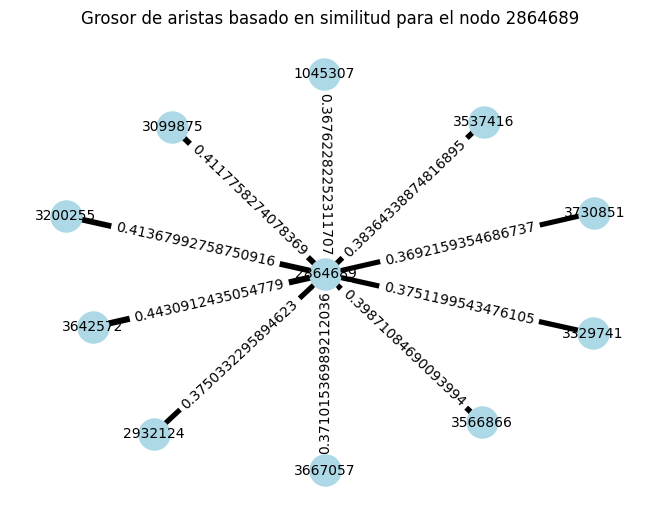

In [51]:
# Crear el grafo vacío
G = nx.Graph()

# Agregar el nodo original
node_id = 2864689
G.add_node(node_id)

recommendations = recommend(node_id)

# Agregar nodos recomendados y sus aristas
for recommendation, similarity in recommendations:
    G.add_node(recommendation)
    G.add_edge(node_id, recommendation, weight=similarity)

# Dibujar el grafo con grosor de aristas basado en la similitud
pos = nx.spring_layout(G)
labels = {node: node for node in G.nodes()}
edge_labels = nx.get_edge_attributes(G, 'weight')

# Ajustar el grosor de las aristas según la similitud
edge_widths = [G[u][v]['weight'] * 10 for u, v in G.edges()]

# Dibujar nodos y aristas
nx.draw(G, pos, with_labels=True, labels=labels, node_color='lightblue', node_size=500, font_size=10, width=edge_widths)
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)

plt.title(f"Grosor de aristas basado en similitud para el nodo {node_id}")
plt.show()

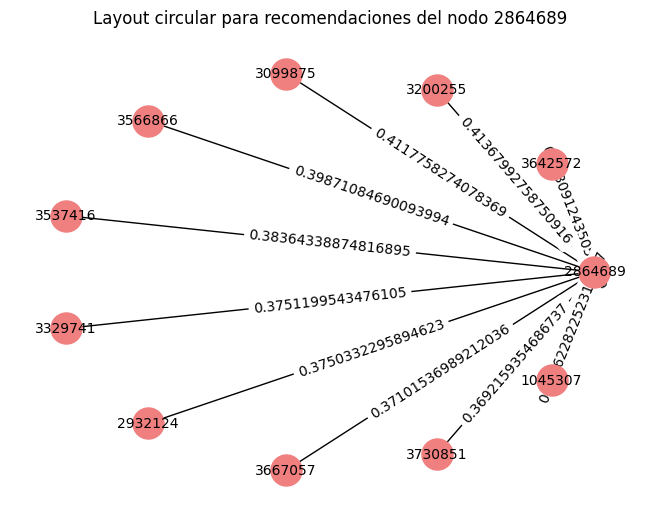

In [52]:
# Crear el grafo vacío
G = nx.Graph()

# Agregar el nodo original
node_id = 2864689
G.add_node(node_id)

recommendations = recommend(node_id)

# Agregar nodos recomendados y sus aristas
for recommendation, similarity in recommendations:
    G.add_node(recommendation)
    G.add_edge(node_id, recommendation, weight=similarity)

# Usar layout circular
pos = nx.circular_layout(G)
labels = {node: node for node in G.nodes()}
edge_labels = nx.get_edge_attributes(G, 'weight')

# Dibujar nodos y aristas
nx.draw(G, pos, with_labels=True, labels=labels, node_color='lightcoral', node_size=500, font_size=10)
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)

plt.title(f"Layout circular para recomendaciones del nodo {node_id}")
plt.show()

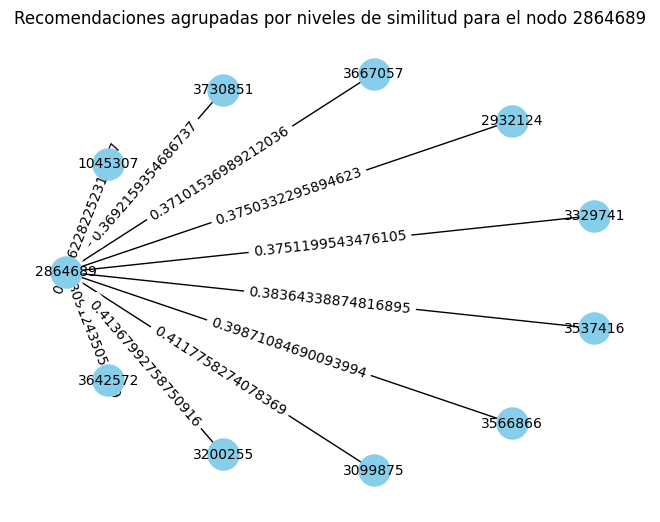

In [53]:
# Crear el grafo vacío
G = nx.Graph()

# Agregar el nodo original
node_id = 2864689
G.add_node(node_id)

recommendations = recommend(node_id)

# Agregar nodos recomendados y sus aristas
for recommendation, similarity in recommendations:
    G.add_node(recommendation)
    G.add_edge(node_id, recommendation, weight=similarity)

# Crear un layout con capas según la similitud (más cercano = más similar)
pos = nx.shell_layout(G)
labels = {node: node for node in G.nodes()}
edge_labels = nx.get_edge_attributes(G, 'weight')

# Dibujar nodos y aristas
nx.draw(G, pos, with_labels=True, labels=labels, node_color='skyblue', node_size=500, font_size=10)
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)

plt.title(f"Recomendaciones agrupadas por niveles de similitud para el nodo {node_id}")
plt.show()

<ipython-input-54-7ae34bea8c7a>:29: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap('coolwarm')


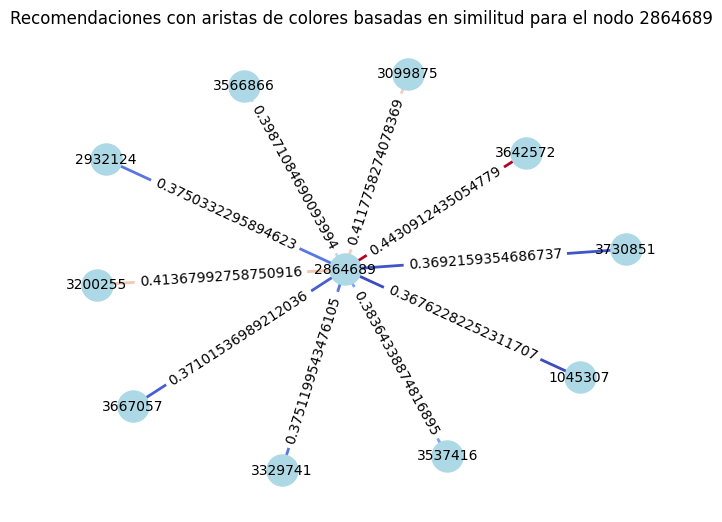

In [54]:
from matplotlib import cm

# Crear el grafo vacío
G = nx.Graph()

# Agregar el nodo original
node_id = 2864689
G.add_node(node_id)

recommendations = recommend(node_id)

# Agregar nodos recomendados y sus aristas
for recommendation, similarity in recommendations:
    G.add_node(recommendation)
    G.add_edge(node_id, recommendation, weight=similarity)

# Normalizar los pesos para el color de las aristas
weights = [G[u][v]['weight'] for u, v in G.edges()]
max_weight = max(weights)
min_weight = min(weights)
normalized_weights = [(w - min_weight) / (max_weight - min_weight) for w in weights]

# Dibujar el grafo con colores de aristas basados en pesos normalizados
pos = nx.spring_layout(G)
labels = {node: node for node in G.nodes()}
edge_labels = nx.get_edge_attributes(G, 'weight')

# Crear un mapa de colores
cmap = cm.get_cmap('coolwarm')

# Dibujar nodos y aristas con colores basados en el peso
nx.draw(G, pos, with_labels=True, labels=labels, node_color='lightblue', node_size=500, font_size=10,
        edge_color=[cmap(w) for w in normalized_weights], width=2)
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)

plt.title(f"Recomendaciones con aristas de colores basadas en similitud para el nodo {node_id}")
plt.show()

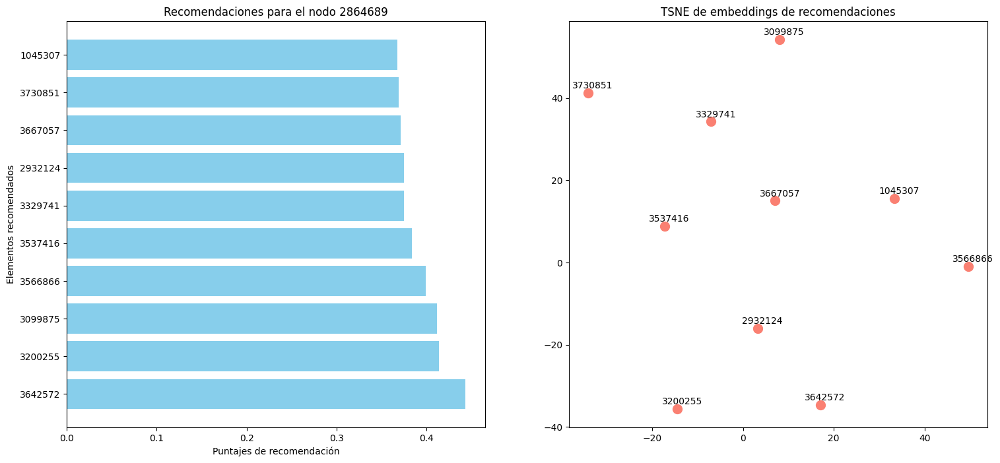

In [56]:
# Descomponer la lista de recomendaciones en elementos y puntajes
elementos = [item[0] for item in recommendations]
puntajes = [item[1] for item in recommendations]

# Simulación del modelo de embeddings (word vectors para cada recomendación)
# Aquí se usa una simulación, reemplaza por tus propios embeddings si los tienes
model_wv_vectors = np.random.rand(len(elementos), 50)  # Simulación de embeddings de 50 dimensiones

# Preprocesar los vectores de palabras (embeddings)
nodes_wv = np.array([model_wv_vectors[i] for i in range(len(elementos))])

# Ajustar la perplexity para que sea menor al número de muestras
tsne = TSNE(n_components=2, perplexity=5, learning_rate='auto', init='pca', random_state=0).fit_transform(nodes_wv)

# Crear una figura para ambos gráficos
fig, ax = plt.subplots(1, 2, figsize=(18, 8))

# Gráfico de barras de las recomendaciones
ax[0].barh(elementos, puntajes, color='skyblue')
ax[0].set_xlabel('Puntajes de recomendación')
ax[0].set_ylabel('Elementos recomendados')
ax[0].set_title('Recomendaciones para el nodo 2864689')

# Gráfico TSNE
ax[1].scatter(tsne[:, 0], tsne[:, 1], s=100, color='salmon')
for i, label in enumerate(elementos):
    ax[1].annotate(label, (tsne[i, 0], tsne[i, 1]), textcoords="offset points", xytext=(5, 5), ha='center')
ax[1].set_title('TSNE de embeddings de recomendaciones')

plt.show()

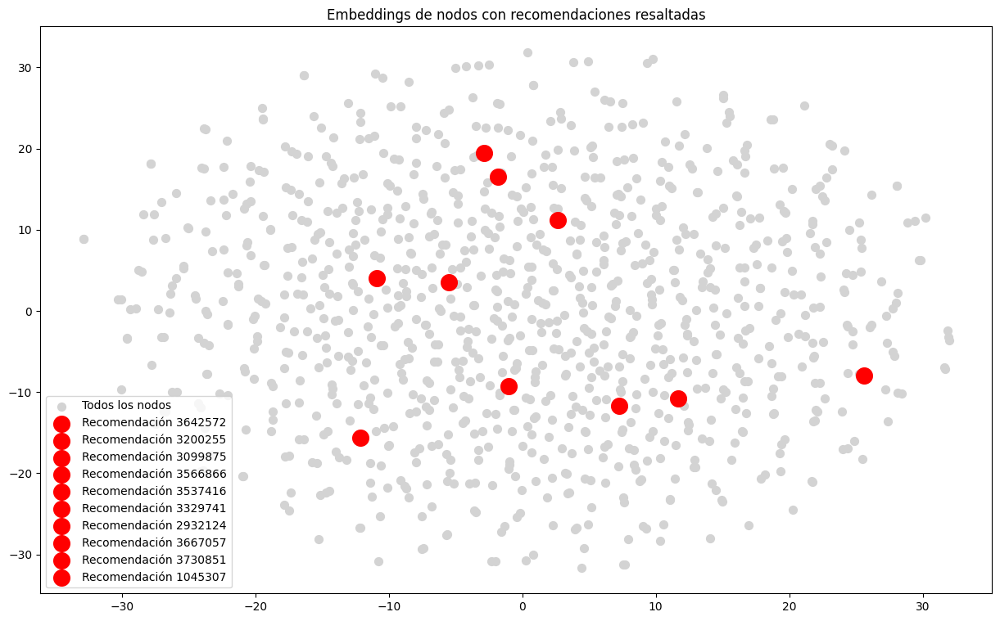

In [57]:
# Simulación de embeddings para todos los nodos (model.wv.index_to_key)
# Reemplázalo con los embeddings reales de tu modelo
all_nodes_wv = np.random.rand(1000, 50)  # Simulación de 1000 nodos y 50 dimensiones

# IDs de recomendaciones
recom_ids = [int(item[0]) for item in recommendations]

# Preprocesar los vectores de palabras (embeddings)
# Reemplaza esta parte por cómo obtienes tus embeddings reales
nodes_wv = np.array([all_nodes_wv[i] for i in range(len(all_nodes_wv))])

# Entrenar TSNE para todos los nodos
tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=0).fit_transform(nodes_wv)

# Crear una figura para el gráfico de TSNE
plt.figure(figsize=(15, 9))

# Graficar todos los nodos
plt.scatter(tsne[:, 0], tsne[:, 1], s=50, color='lightgray', label='Todos los nodos')

# Graficar los puntos de las recomendaciones en el mismo gráfico
for recom_id in recom_ids:
    recom_idx = recom_id % len(tsne)  # Asegura que los IDs estén en rango
    plt.scatter(tsne[recom_idx, 0], tsne[recom_idx, 1], s=200, color='red', label=f'Recomendación {recom_id}')

# Agregar leyenda y mostrar el gráfico
plt.title('Embeddings de nodos con recomendaciones resaltadas')
plt.legend(loc='best')
plt.show()